In [239]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
from PIL import Image
import geopandas
from shapely.geometry import Point
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

In [240]:
headers = {'User-Agent': 
           'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/47.0.2526.106 Safari/537.36'}

In [241]:
# root reference page
page_main = "https://www.transfermarkt.de/1-bundesliga/tabelle/wettbewerb/L1/saison_id/"

img_clubs = []
clubs = []

# iterate over all season tables
for i in range(1991, 2022):
    page = page_main + str(i)
    
    # send get request, returns response object
    pageTree = requests.get(page, headers=headers)
    
    # get content of response with bs4, parse into bs4 object soup to work with it 
    pageSoup = BeautifulSoup(pageTree.content, 'html.parser')
    
    div = pageSoup.find('div', {"class": "responsive-table"})
    links = div.find_all('a', {"class": "vereinprofil_tooltip"})
    imgs = div.find_all('img')
    
    # get club logo links
    for img in imgs:
        if img.parent.get(key='class') is not None:
            img_clubs.append((i, img['src'], img.parent.get(key='id')))
            
    # get club ids 
    for link in links:
        parent = link.parent.name
        if 'no-border-links' in link.parent.get(key='class'):
            clubs.append((i, link.text, link.get(key='id')))
            

clubs_df = pd.DataFrame(clubs)
clubs_df.rename(columns={0: "year", 1: "club_name", 2: "id"}, inplace=True)
            
img_df = pd.DataFrame(img_clubs)
img_df.replace({'tiny': 'normquad'}, regex=True, inplace=True)
clubs_df.head()

,year,club_name,id
0,1991,VfB Stuttgart,79
1,1991,Bor. Dortmund,16
2,1991,E. Frankfurt,24
3,1991,1.FC Köln,3
4,1991,1.FC K'lautern,2


In [242]:
# get and save club logos
for idx, row in img_df.iterrows():
        img = Image.open(requests.get(row[1], stream = True).raw)
        img.save('club_logos/image_' + str(row[0]) + '_' + str(row[2]) + '.png')

In [243]:
# lat long coordinates of all clubs
# coordinates are edited when clubs are too close together (true coordinates next to it)
clubs_geo_data = [("86", 53.065488, 8.838888),
("71", 48.677521, 9.067002), # true: 48.753821, 9.188020
("27", 48.105136, 11.717113), # true: 48.101849, 11.572961
("24", 50.068387, 8.645674),
("16", 51.498018, 7.450915),
("15", 51.038208, 7.002535),
("48", 49.019355, 8.412145),
("79", 48.789840, 9.234628),
("2", 49.434367, 7.776569),
("18", 51.174310, 6.384780),
("33", 51.559355, 7.062919),
("41", 53.606840, 9.858091), # true: 53.586476, 9.900341
("3", 50.907275, 6.906167),
("4", 49.434661, 11.131005),
("97", 51.466889, 7.091058), #true 51.485062, 7.118886
("129", 51.040502, 13.747457),
("80", 51.490429, 7.236476),
("95", 51.338732, 6.603806),
("1", 49.248776, 6.985078),
("52", 51.408959, 6.777525),
("60", 47.988966, 7.892822),
("10848", 51.302549, 12.418228),
("72", 48.102031, 11.474979), # true: 48.101732, 11.565087
("30", 54.084745, 12.092953),
("38", 51.225452, 6.828394),
("35", 53.537987, 10.000037), # true: 53.553739, 9.966931
("10", 52.031761, 8.517214),
("44", 52.519116, 13.239796),
("82", 52.432807, 10.802811),
("66", 47.993455, 11.625199), # true: 48.073961, 11.615665
("69", 48.405062, 10.009519),
("25", 51.752015, 14.344887),
("42", 52.358694, 9.732028),
("39", 50.001003, 8.244422),
("8", 50.793453, 6.095822),
("533", 49.292139, 8.816254),
("167", 48.395995, 10.883085),
("65", 49.500719, 10.996470),
("23", 52.289762, 10.523148),
("127", 51.726007, 8.718736),
("4795", 48.745773, 11.486674),
("105", 49.889667, 8.673402),
("23826", 51.344007, 12.341999),
("89", 52.457549, 13.569484)]

In [244]:
# put geo data into a data frame
geo_df = pd.DataFrame(clubs_geo_data)
geo_df.rename(columns={0: "id", 1: "latitude", 2: "longitude"}, inplace=True)

# with shapely create Point out of lat and long coordinates
geo_df['coordinates']  = list(zip(geo_df.longitude, geo_df.latitude))
geo_df['coordinates'] = geo_df['coordinates'].apply(Point)
geo_df.head()

,id,latitude,longitude,coordinates
0,86,53.065488,8.838888,POINT (8.838888000000001 53.065488)
1,71,48.677521,9.067002,POINT (9.067002 48.677521)
2,27,48.105136,11.717113,POINT (11.717113 48.105136)
3,24,50.068387,8.645674,POINT (8.645674 50.068387)
4,16,51.498018,7.450915,POINT (7.450915 51.498018)


In [259]:
# inner join of both data frames on id and make it a geopandas data frame
clubs_geo_df = pd.merge(clubs_df, geo_df, on='id')
clubs_geo_df.to_csv('bundesliga_vereine_data.csv', index=False)
clubs_geo_df = geopandas.GeoDataFrame(clubs_geo_df, geometry='coordinates')
clubs_geo_df.head()

,year,club_name,id,latitude,longitude,coordinates
0,1991,VfB Stuttgart,79,48.78984,9.234628,POINT (9.23463 48.78984)
1,1992,VfB Stuttgart,79,48.78984,9.234628,POINT (9.23463 48.78984)
2,1993,VfB Stuttgart,79,48.78984,9.234628,POINT (9.23463 48.78984)
3,1994,VfB Stuttgart,79,48.78984,9.234628,POINT (9.23463 48.78984)
4,1995,VfB Stuttgart,79,48.78984,9.234628,POINT (9.23463 48.78984)


In [260]:
# geopandas setting
germany = geopandas.read_file("data/germany/vg2500_bld.shp")
germany_mercator = germany.to_crs(epsg=3395)  # or .to_crs({'init': 'epsg:3395'})
clubs_geo_df.crs = {'init' :'epsg:4326'}
clubs_geo_df_mercator = clubs_geo_df.to_crs(epsg=3395)

/home/philipp/miniconda3/envs/ds/lib/python3.7/site-packages/pyproj/crs/crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


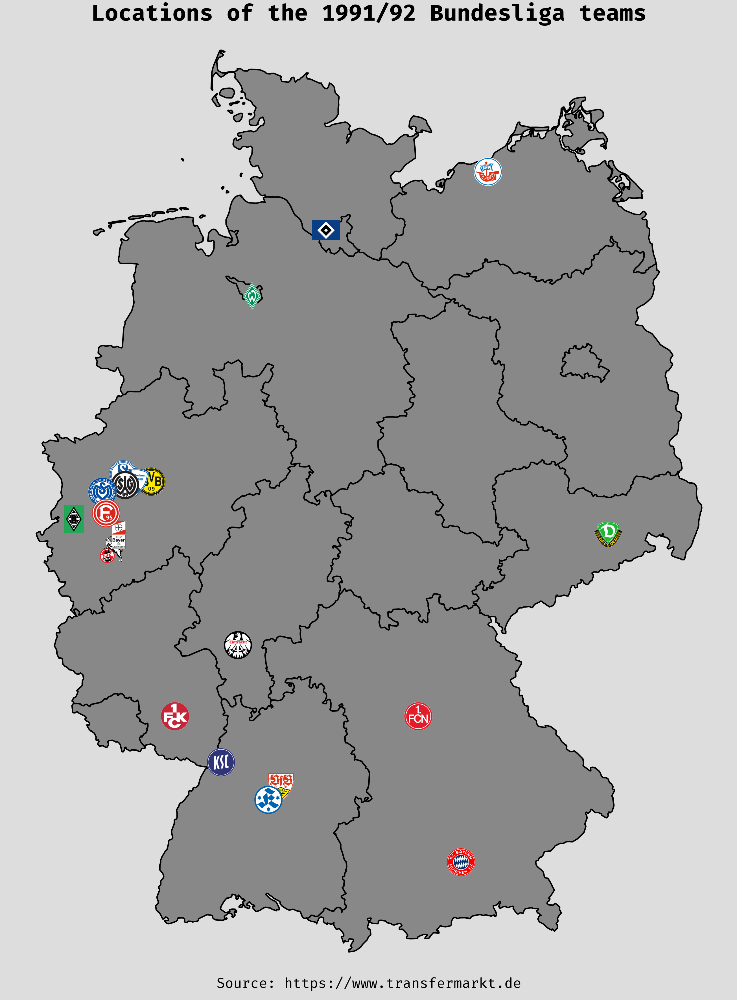

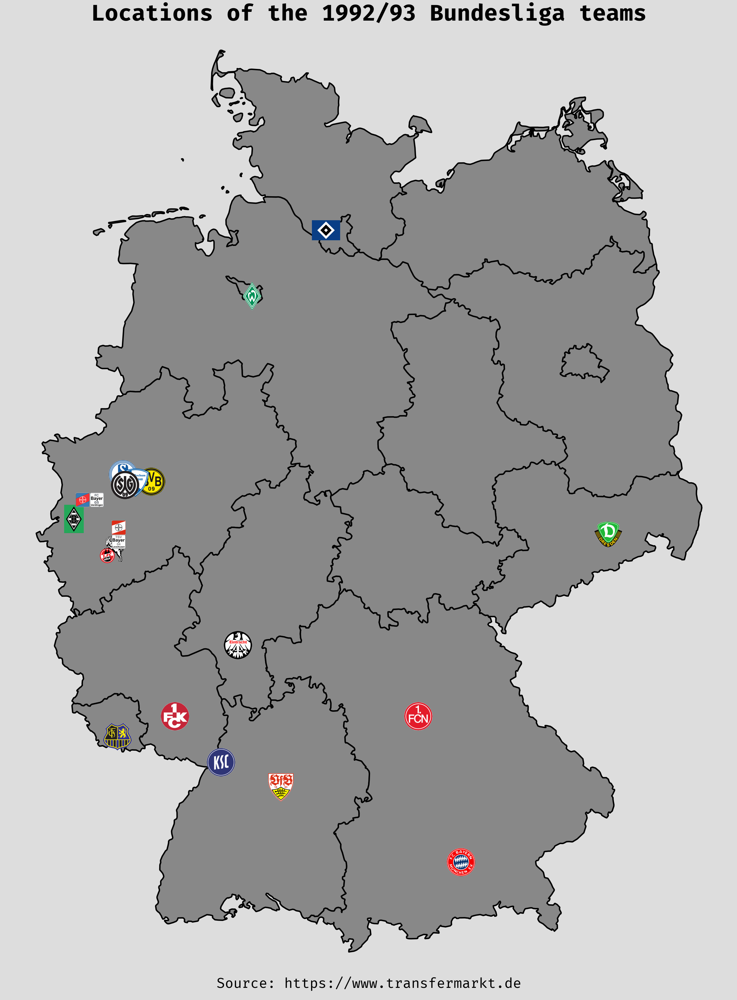

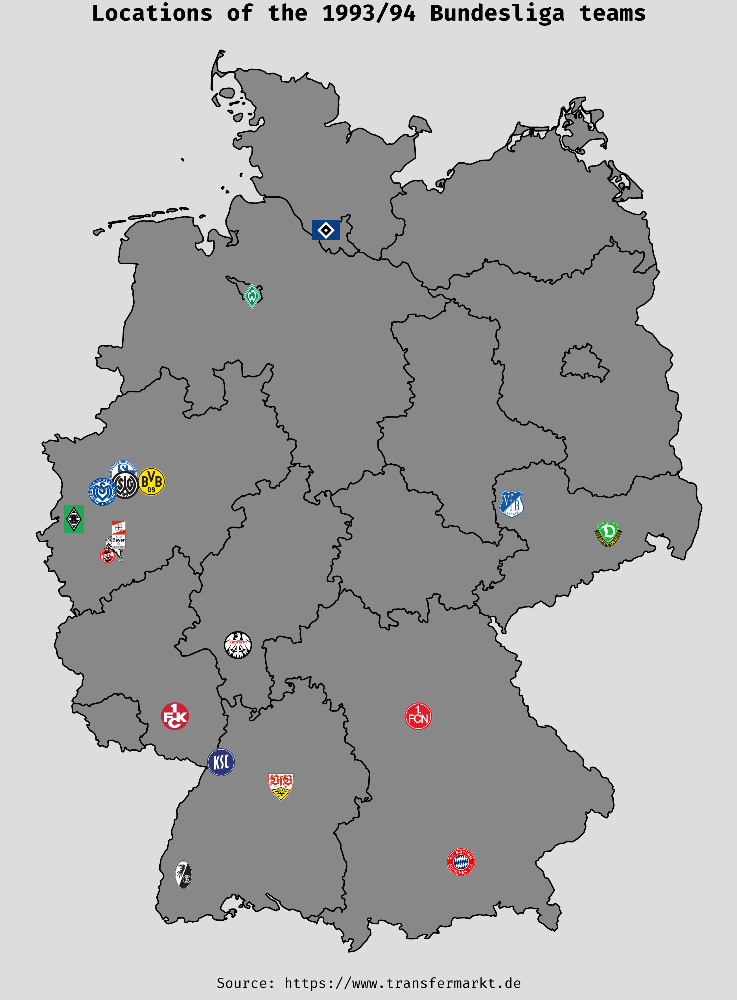

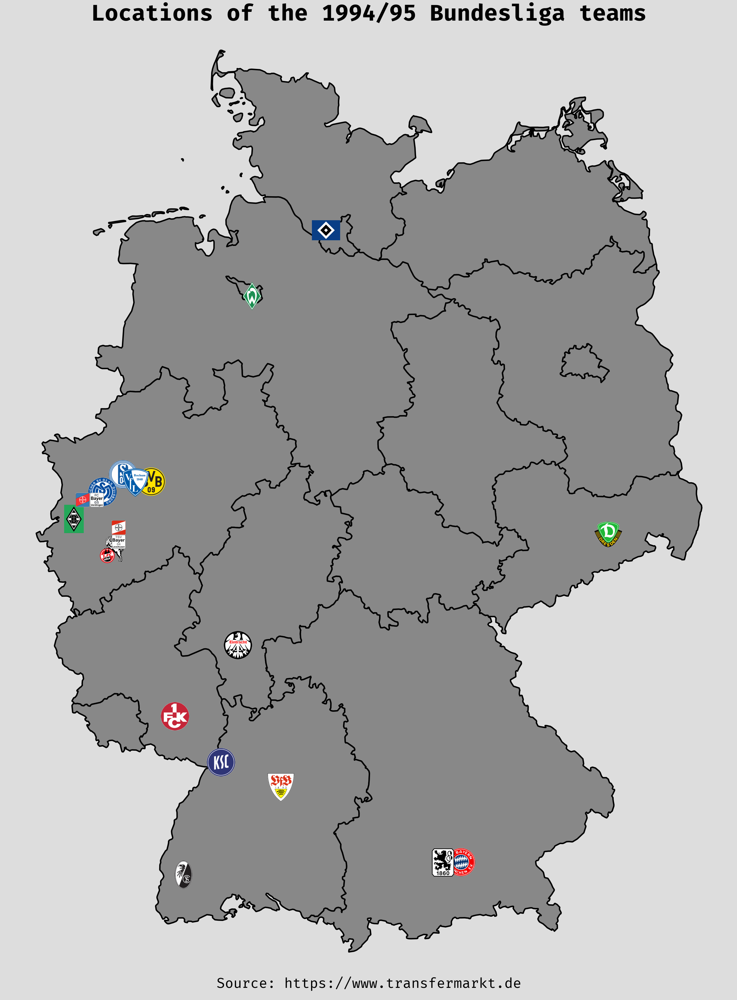

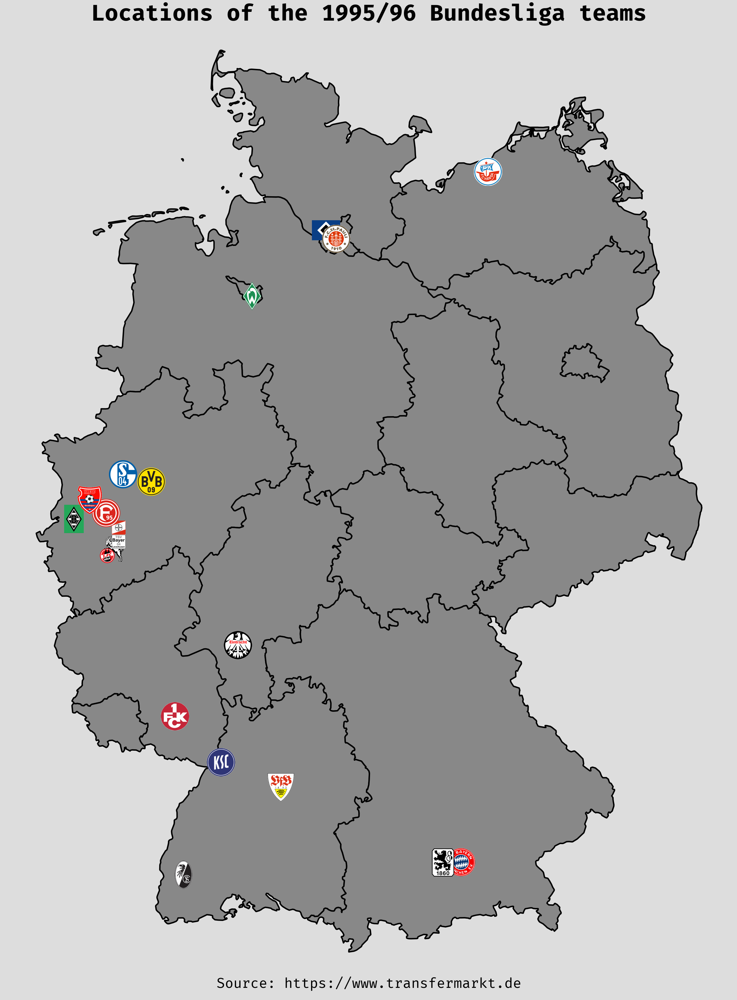

...

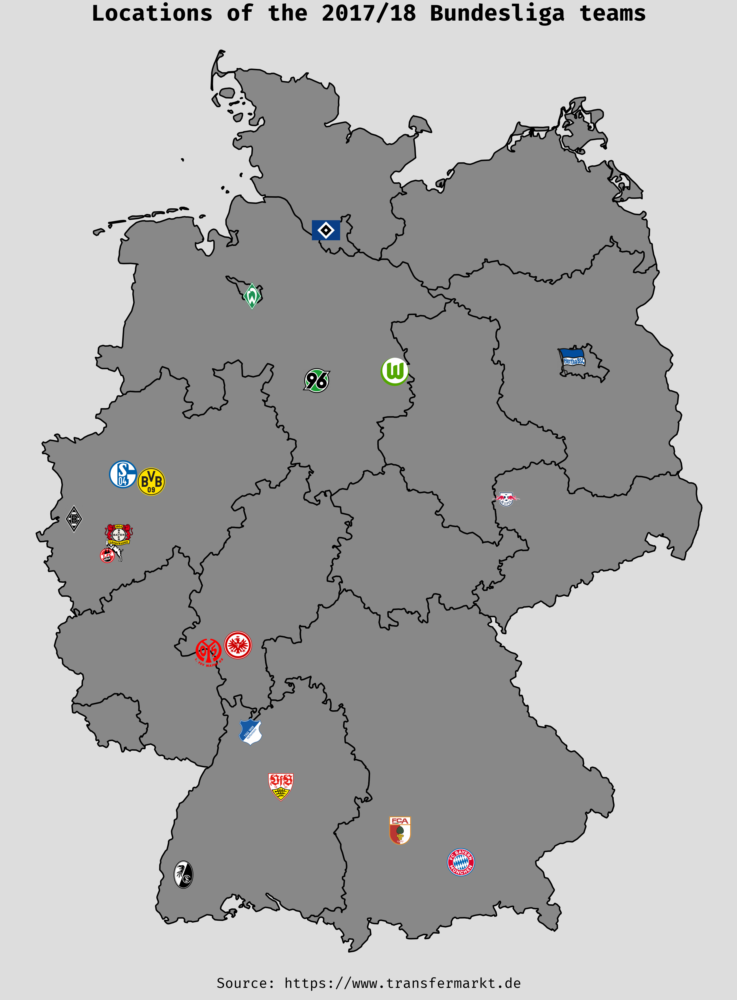

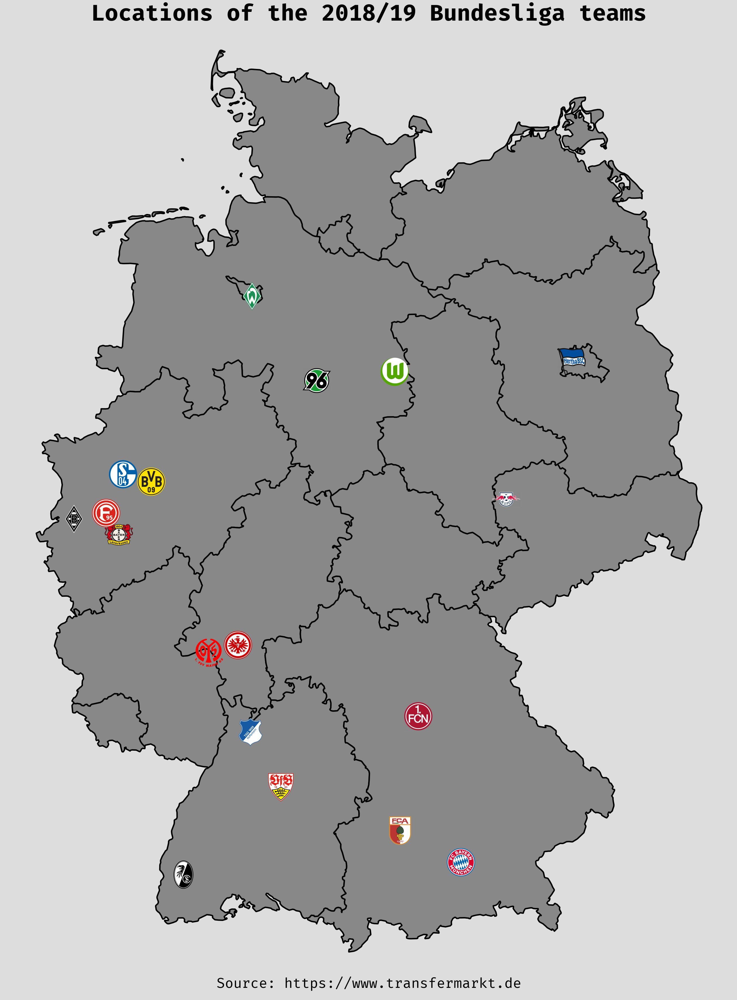

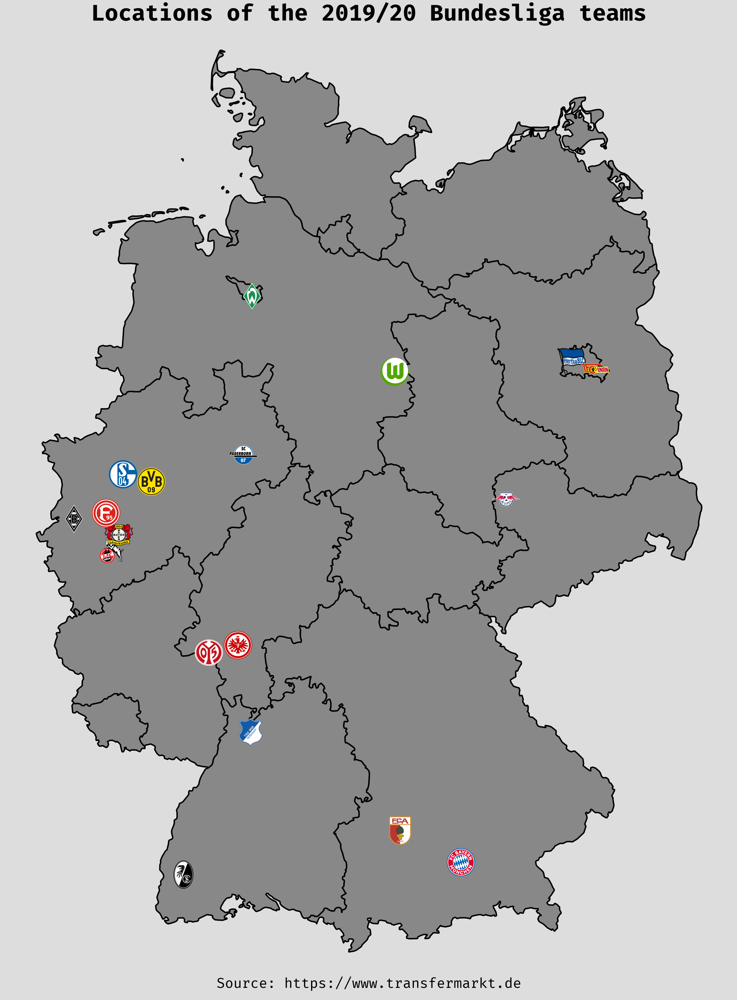

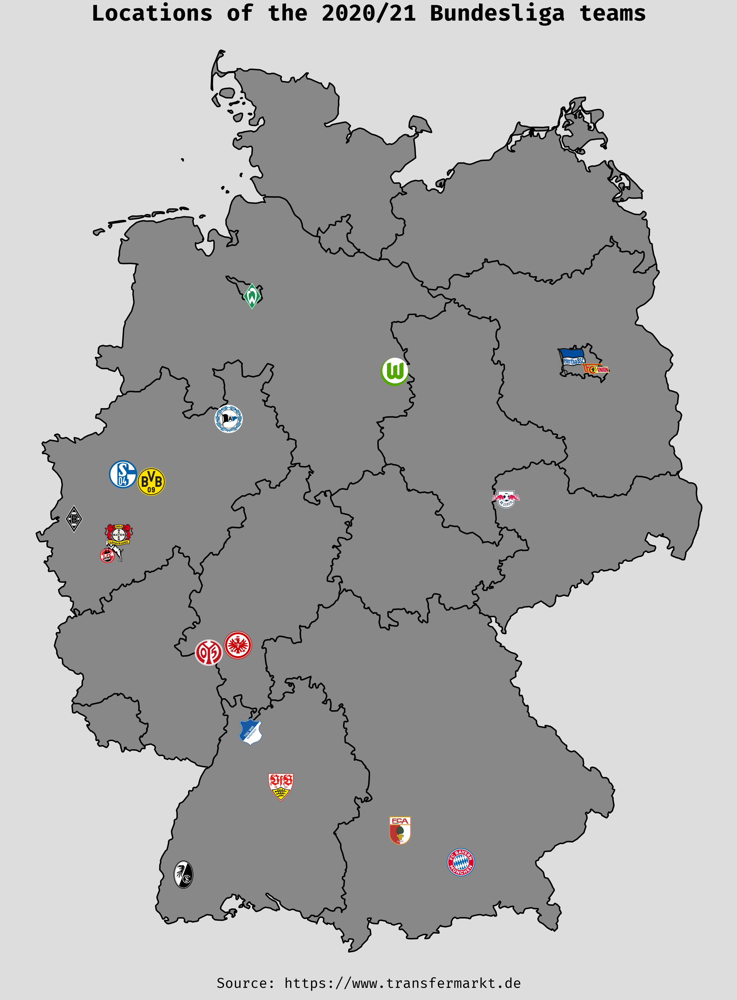

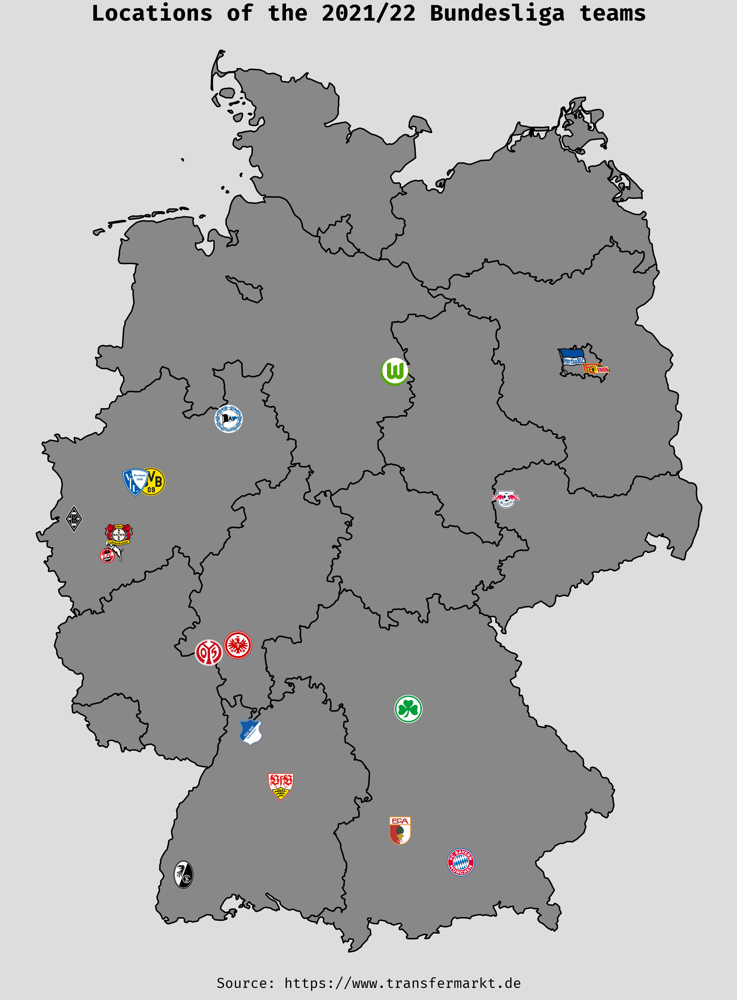

In [263]:
plt.rcParams['font.family'] = 'Fira Mono'
plt.rcParams['axes.edgecolor'] = '#dddddd'
def getImage(path):
    return OffsetImage(plt.imread(path))

for i in range(1991, 2022):
    df =  clubs_geo_df_mercator.loc[clubs_geo_df_mercator['year'] == i, :]
    
    fig, ax = plt.subplots(figsize=(50, 50))
    germany_mercator.plot(ax=ax, edgecolor='k', linewidth=5, facecolor="#888888")
    
    if (i >= 1999) & (i < 2009):
        fig.suptitle('Locations of the ' + str(i) + '/' + '0' + str(i-2000+1) + ' Bundesliga teams', fontsize=80, fontweight='bold')
    elif i >= 2009:
        fig.suptitle('Locations of the ' + str(i) + '/' + str(i-2000+1) + ' Bundesliga teams', fontsize=80, fontweight='bold')
    else:
        fig.suptitle('Locations of the ' + str(i) + '/' + str(i-1900+1) + ' Bundesliga teams', fontsize=80, fontweight='bold')
        
    for idx, row in df.iterrows():
        ab = AnnotationBbox(getImage('club_logos/image_' + str(row.year) + '_' + str(row.id) + '.png'), (row.coordinates.x, row.coordinates.y), frameon=False)
        ax.add_artist(ab)

    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_yticks([])
    ax.set_xticks([])
    ax.set_facecolor("#dddddd")
    fig.set_facecolor("#dddddd")
    plt.tight_layout(pad=0.0)
    plt.figtext(0.5, 0.01, "Source: https://www.transfermarkt.de", ha="center", fontsize=50)
    fig.savefig("img/bundesliga_"+str(i)+".png", bbox_inches='tight', pad_inches=1.0, facecolor=fig.get_facecolor())
    plt.show()